In [1]:
import pyVHR as vhr
import numpy as np
import matplotlib.pyplot as plt

# Plotting: set 'colab' for Google Colaboratory, 'notebook' otherwise
vhr.plot.VisualizeParams.renderer = 'notebook'  # or 'notebook'

In [2]:
# -- LOAD A DATASET
dataset_name = 'lgi_ppgi'          # the name of the python class handling it 
video_DIR = '../cpi/cpi_resting/'  # dir containing videos
BVP_DIR = '../cpi/cpi_resting/'    # dir containing BVPs GT

dataset = vhr.datasets.datasetFactory(dataset_name, videodataDIR=video_DIR, BVPdataDIR=BVP_DIR)

dataset.video_EXT = 'mp4'
dataset.__init__(videodataDIR=video_DIR, BVPdataDIR=BVP_DIR)
allvideo = dataset.videoFilenames

# print the list of video names with the progressive index (idx)
for v in range(len(allvideo)):
  print(v, allvideo[v])

0 ../cpi/cpi_resting/cv_camera_sensor_stream_handler.mp4


In [3]:
# -- PARAMETER SETTING
wsize = 8          # seconds of video processed (with overlapping) for each estimate 
video_idx = 0      # index of the video to be processed
fname = dataset.getSigFilename(video_idx)
sigGT = dataset.readSigfile(fname)
test_bvp = sigGT.data
bpmGT, timesGT = sigGT.getBPM(wsize)
videoFileName = dataset.getVideoFilename(video_idx)
print('Video processed name: ', videoFileName)
fps = vhr.extraction.utils.get_fps(videoFileName)
print('Video frame rate:     ',fps)

Video processed name:  ../cpi/cpi_resting/cv_camera_sensor_stream_handler.mp4
Video frame rate:      25.0


In [4]:
sigGT.displaySpectrum(display=True)

# Skin extraction

Estract the skin by two methods (using the `SignalProcessing` class):
* **convex hull** on landmarks by [MediaPipe Face Mesh](https://google.github.io/mediapipe/solutions/face_mesh) (a face geometry solution that estimates 468 3D face landmarks in real-time)
* **face parsing** by the BiSeNet CNN (see [face-parsing.PyTorch](https://github.com/zllrunning/face-parsing.PyTorch))

Once the skin is selected, select how to process it: 

* **Patches**: small facial regions of skin  centered on landmarks (provides multiple estimators)
* **Holistic**: convex hull of patches or face parsing CNN (provides a single  estimator)

***Note***: `SignalProcessing` is powered by CUDA

In [5]:
sig_extractor = vhr.extraction.SignalProcessing()
# sig_extractor.display_cuda_device()
# sig_extractor.choose_cuda_device(0)

Use convex hull or face parsing to extract the skin

In [6]:
# CPU based
sig_extractor.set_skin_extractor(vhr.extraction.SkinExtractionConvexHull())
#sig_extractor.set_skin_extractor(vhr.extraction.SkinExtractionFaceParsing('CPU'))

# GPU based
# sig_extractor.set_skin_extractor(vhr.extraction.SkinExtractionConvexHull('GPU'))
#sig_extractor.set_skin_extractor(vhr.extraction.SkinExtractionFaceParsing('GPU'))

Choose a specific number of frames of the video to process... 

In [86]:
# set the number of seconds (0 for all video)
seconds = 20
sig_extractor.set_total_frames(seconds*fps)

### Color-thresholding

**OPTIONAL**: Both signal extraction and skin extraction have a color-threshold filter for removing unwanted RGB colors. We can set the RGB threshold interval using theese classes:

In [87]:
vhr.extraction.SkinProcessingParams.RGB_LOW_TH = 2
vhr.extraction.SkinProcessingParams.RGB_HIGH_TH = 254

vhr.extraction.SignalProcessingParams.RGB_LOW_TH = 2
vhr.extraction.SignalProcessingParams.RGB_HIGH_TH = 254

## Visualize skin and landmarks 

* To visualize skin processing intermediate results call `set_visualize_skin_and_landmarks` method.
* To retrieve any intermediate result call the methods `get_visualize_skin` and 
`get_visualize_patches`

<img src='https://github.com/giulianogrossi/imgs/blob/main/pyVHR/landmark_on_face.png?raw=true' width=300px >

In [88]:
# -- SET VISUALIZATION MODE 
sig_extractor.set_visualize_skin_and_landmarks(
      visualize_skin=True, 
      visualize_landmarks=True, 
      visualize_landmarks_number=True, 
      visualize_patch=True)

In [89]:
# -- DEFINE A LANDMARK SUBSET

# choose predefined...
landmarks = vhr.extraction.MagicLandmarks.cheek_left_top +\
                   vhr.extraction.MagicLandmarks.forehead_center +\
                   vhr.extraction.MagicLandmarks.forehoead_right +\
                   vhr.extraction.MagicLandmarks.cheek_right_top +\
                   vhr.extraction.MagicLandmarks.forehead_left +\
                   vhr.extraction.MagicLandmarks.nose 

# ... or sample the face by 100 equispaced landmarks
# landmarks = [2, 3, 4, 5, 6, 8, 9, 10, 18, 21, 32, 35, 36, 43, 46, 47, 48, 50, 54, \
#              58, 67, 68, 69, 71, 92, 93, 101, 103, 104, 108, 109, 116, 117, \
#              118, 123, 132, 134, 135, 138, 139, 142, 148, 149, 150, 151, 152, 182, 187, 188, 193, 197, 201, 205, 206, 207, \
#              210, 211, 212, 216, 234, 248, 251, 262, 265, 266, 273, 277, 278, 280, \
#              284, 288, 297, 299, 322, 323, 330, 332, 333, 337, 338, 345, \
#              346, 361, 363, 364, 367, 368, 371, 377, 379, 411, 412, 417, 421, 425, 426, 427, 430, 432, 436]



In [90]:
# -- SET THE LANDMARK LIST
sig_extractor.set_landmarks(landmarks)

# ROI processing and RGB computation

Choose how to extract the RGB signal from ROI:

* **Holistic** mean
* **Patches** mean

Patches are square (with a fixed edge for all) or rectangular (with xy_dimension for each region).


## Holistic extraction

In [91]:
# -- HOLISTIC EXTRACTION
hol_sig = sig_extractor.extract_holistic(videoFileName)
print('Size: (#frames, #landmarks, #channels) = ',hol_sig.shape)

Size: (#frames, #landmarks, #channels) =  (500, 1, 3)


In [92]:
# -- INTERACTIVE VISUALIZATION OF PATCHES
visualize_skin_coll = sig_extractor.get_visualize_skin()
print('Number of frames processed: ',len(visualize_skin_coll))
vhr.plot.interactive_image_plot(visualize_skin_coll,1.0)

Number of frames processed:  500


interactive(children=(IntSlider(value=0, description='x', max=499), Output()), _dom_classes=('widget-interact'…

## Signal windowing

Windowing means to split a video into a set of strided and overlapped windows of frames. For each window the RGB signal is estracted by averaging over pixels in holistic (all skin pixels) or local (averaging on patches) fashion. Shapes are `(rgb_channels, #frames)` and `(#landmarks, rgb_channels, #frames)` respectively. 

### Holistic


In [93]:
# -- WINDOWING OF RGB SIGNALS (HOLISTIC)
windowed_hol_sig, timesES = vhr.extraction.sig_windowing(hol_sig, wsize, 1, fps)
print('Num windows: ',len(windowed_hol_sig))
print('Num channels and window length: ', windowed_hol_sig[0].shape)

Num windows:  13
Num channels and window length:  (1, 3, 200)


(174.0, 179.0)

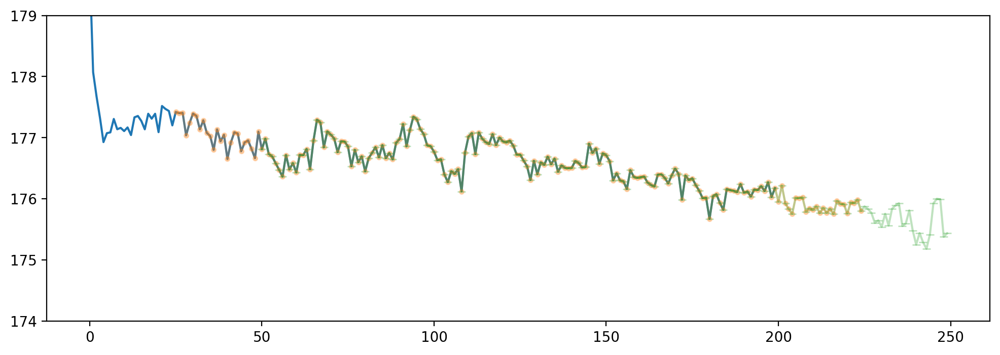

In [124]:
# bare lige for at se hvordan vinduerne overlapper
plt.figure(figsize=(12,4),dpi=200)
plt.plot(range(200),windowed_hol_sig[0][0][0])
plt.plot(range(25,200+25), windowed_hol_sig[1][0][0],marker='.',alpha=0.3)
plt.plot(range(50,200+50), windowed_hol_sig[2][0][0],marker='_',alpha=0.3)
plt.ylim(174,179)

In [43]:
# -- PLOT A WINDOW (randomly chosen)
wind = np.random.randint(0, len(windowed_hol_sig))   # window number
vhr.plot.visualize_windowed_sig(windowed_hol_sig, wind)

# Pre-filtering

The implemented (standard) filters are:

* `rgb_filter_ths`: color threshold filter that filters out signals that, in at least one frame of the window, are outside the rgb colors interval `[(LOW, LOW, LOW), (HIGH, HIGH, HIGH)]` where `LOW` is the dictionary parameter `RGB_LOW_TH`, and `HIGH` is `RGB_HIGH_TH` (we suggest to always use this filter before applying a BVP method)
* `detrend`: apply detrend to the signal
* `sg_detrend`: apply detrend to the signal, i.e. remove the low-frequency components with the low-pass filter developed by Savitzky-Golay
* `zscore`: apply z-score to the signal
* `BPfilter`: apply Butterworth band-pass filter to the signal

### Holistic

In [132]:
# -- APPLY TRESHOLDING ON RGB COLORS (suggested)

filtered_windowed_hol_sig = vhr.BVP.apply_filter(windowed_hol_sig, vhr.BVP.rgb_filter_th, params={'RGB_LOW_TH': 0, 'RGB_HIGH_TH': 255})
print('Num windows: ', len(filtered_windowed_hol_sig))
print('Win size: (#signals, #channels, #frames) = ', filtered_windowed_hol_sig[0].shape)

Num windows:  13
Win size: (#signals, #channels, #frames) =  (1, 3, 200)


In [133]:
# -- SELECT THE FILTER CASCADE

filtered_windowed_hol_sig = vhr.BVP.apply_filter(filtered_windowed_hol_sig, vhr.BVP.BPfilter, params={'order':6,'minHz':0.65,'maxHz':4.0,'fps':fps})
#filtered_windowed_hol_sig = vhr.BVP.apply_filter(filtered_windowed_hol_sig, vhr.BVP.detrend)
#filtered_windowed_hol_sig = vhr.BVP.apply_filter(filtered_windowed_hol_sig, vhr.BVP.sg_detrend)
#filtered_windowed_hol_sig = vhr.BVP.apply_filter(filtered_windowed_hol_sig, vhr.BVP.zscore)
#filtered_windowed_hol_sig = vhr.BVP.apply_filter(filtered_windowed_hol_sig, vhr.BVP.zeromean)
print('Num windows: ', len(filtered_windowed_hol_sig))
print('Win size: (#signals, #channels, #frames) = ', filtered_windowed_hol_sig[0].shape)

Num windows:  13
Win size: (#signals, #channels, #frames) =  (1, 3, 200)


In [134]:
filtered_windowed_hol_sig

[array([[[ 7.69184446e-03, -9.75419990e-01, -1.67227293e+00,
          -1.93464690e+00, -1.80549037e+00, -1.46284117e+00,
          -1.10303760e+00, -8.42008770e-01, -6.86914635e-01,
          -5.76013388e-01, -4.44348922e-01, -2.68970725e-01,
          -7.28270890e-02,  1.02383148e-01,  2.27889012e-01,
           3.02285298e-01,  3.44363382e-01,  3.75620221e-01,
           4.07373154e-01,  4.39351971e-01,  4.65914369e-01,
           4.81700433e-01,  4.82302071e-01,  4.62147466e-01,
           4.15027174e-01,  3.39876087e-01,  2.47785554e-01,
           1.61841932e-01,  1.05195609e-01,  8.38104814e-02,
           7.86234243e-02,  5.69649482e-02, -3.23449785e-03,
          -9.59047084e-02, -1.91354392e-01, -2.59319166e-01,
          -2.90386086e-01, -2.97310137e-01, -2.96767950e-01,
          -2.90598825e-01, -2.65460359e-01, -2.10923756e-01,
          -1.37069757e-01, -7.25594790e-02, -4.29060121e-02,
          -4.78629108e-02, -5.85946798e-02, -3.87190840e-02,
           2.66193767e-0

In [135]:
# -- PLOT A WINDOW (randomly chosen)
w = np.random.randint(0, len(windowed_hol_sig))  # window number
vhr.plot.visualize_windowed_sig(filtered_windowed_hol_sig, w)

# Method: BVP extraction

To extract the BVP signal call the function `RGB_sig_to_BVP` with the following parameters:


*   `filt_windowed_sig`: the list of windows
*   `fps`: frame rate
*   `device_type`: `cuda`, `cpu`, `torch`
*   `method`: method function that supports method_type device
*   params: dictionary of parameters needed by the method ( default is {}).

Methods implemented:
* device_type cuda: cupy_CHROM, POS, ...

***Note***: pyVHR contains many methods, but you can also use a custom method. Remember that it must accept a numpy.ndarray with shape (num_estimators, channels, num_frames) and return a numpy.ndarray with shape (num_estimators, num_frames)


### Holistic

In [140]:
def cpu_ICA2(signal, **kargs):
    """
    ICA method on CPU using Numpy.

    The dictionary parameters are {'component':str}. Where 'component' can be 'second_comp' or 'all_comp'.

    Poh, M. Z., McDuff, D. J., & Picard, R. W. (2010). Non-contact, automated cardiac pulse measurements using video imaging and blind source separation. Optics express, 18(10), 10762-10774.    
    """
    bvp = []
    for X in signal:
        W = jadeR(X, verbose=False)   #W is a 3x3 matrix
        bvp.append(np.dot(W,X))
    
    # selector
    bvp = np.array(bvp)
    l, c, f = bvp.shape     # l=#landmks c=#3chs, f=#frames
    if kargs['component']=='all_comp':
        bvp = np.reshape(bvp, (l*c, f))  # compact into 2D matrix 
    elif kargs['component']=='second_comp':
        bvp = np.reshape(bvp[:,1,:], (l, f))
    
    # collect
    return bvp

In [141]:
# -- APPLY A METHOD TO EXTRACT BVP

from pyVHR.BVP import *

# hol_bvps = RGB_sig_to_BVP(windowed_hol_sig, fps, device_type='cpu', method=cpu_CHROM)
#hol_bvps = RGB_sig_to_BVP(windowed_hol_sig, fps, device_type='cuda', method=cupy_CHROM)
#hol_bvps = RGB_sig_to_BVP(windowed_hol_sig, fps, device_type='torch', method=torch_CHROM)
#hol_bvps = RGB_sig_to_BVP(windowed_hol_sig, fps, device_type='cuda', method=cupy_POS, params={'fps':fps})
# hol_bvps = RGB_sig_to_BVP(windowed_hol_sig, fps, device_type='cpu', method=cpu_POS, params={'fps':fps})
#hol_bvps = RGB_sig_to_BVP(windowed_hol_sig, fps, device_type='cpu', method=cpu_LGI)
#hol_bvps = RGB_sig_to_BVP(windowed_hol_sig, fps, device_type='cpu', method=cpu_GREEN)
hol_bvps = RGB_sig_to_BVP(windowed_hol_sig, fps, device_type='cpu', method=cpu_ICA2, params={'component':'all_comp'})

print('Number of windows: ', len(hol_bvps))
print('Number of estimators and number of number of frames in a windows: ', hol_bvps[0].shape)

Number of windows:  13
Number of estimators and number of number of frames in a windows:  (3, 200)


*bvps* is a list of length num_windows of numpy.ndarray with shape (num_estimators,num_frames)

In [142]:
# -- PLOT A WINDOW (randomly chosen)

w = np.random.randint(0, len(windowed_hol_sig))  # window number
vhr.plot.visualize_BVPs(hol_bvps, w)
#TODO spectrogram på hver signal her

# Post Filtering

We can apply all the filters showed before also to the *BVP*. 

In [49]:
# -- APPLY BPFILTER TO BVP WINDOWED 

hol_bvps = vhr.BVP.apply_filter(hol_bvps, BPfilter, params={'order':6,'minHz':0.65,'maxHz':4.0,'fps':fps})
print('Num windows: ', len(hol_bvps))

Num windows:  65


In [50]:
# -- PLOT A WINDOW (randomly chosen)
wind = np.random.randint(0, len(windowed_hol_sig))  # window number
vhr.plot.visualize_BVPs(hol_bvps, wind)

## BVP spectrum

BVP spectrum analysis via PSD for holistic and patches approaches.
### Holistic

In [51]:
w = np.random.randint(0, len(windowed_hol_sig))  # window number
vhr.plot.visualize_BVPs_PSD(hol_bvps, w, fps)

# BPM estimation 

This function process all the windows and all the estimators (one for holistic and many for patches), and returns a list of numpyndarray with shape (num_estimators,).


In [52]:
# -- BPM ESTIMATION 

hol_bpmES = vhr.BPM.BVP_to_BPM(hol_bvps, fps)       # CPU version
#hol_bpmES = vhr.BPM.BVP_to_BPM_cuda(hol_bvps, fps)  # CUDA version

# BPM vs GT ANALYSIS

Error computation and visualization 

In [53]:
print(len(hol_bpmES), len(bpmGT), len(timesES), len(timesGT))

65 75 65 75


In [69]:
# from pyVHR.utils.errors import MAEerror, MAXError, PearsonCorr, LinCorr

# def getErrors2(bpmES, bpmGT, timesES, timesGT):
    
#     if type(bpmES) == list:
#         bpmES = np.expand_dims(bpmES, axis=0)
#     if type(bpmES) == np.ndarray:
#         if len(bpmES.shape) == 1:
#             bpmES = np.expand_dims(bpmES, axis=0)

#     RMSE = RMSEerror2(bpmES, bpmGT, timesES, timesGT)
#     MAE = MAEerror(bpmES, bpmGT, timesES, timesGT)
#     MAX = MAXError(bpmES, bpmGT, timesES, timesGT)
#     PCC = PearsonCorr(bpmES, bpmGT, timesES, timesGT)
#     CCC = LinCorr(bpmES, bpmGT, timesES, timesGT)
#     return RMSE, MAE, MAX, PCC, CCC

# def RMSEerror2(bpmES, bpmGT, timesES=None, timesGT=None):
#     """ RMSE: """

#     diff = bpm_diff2(bpmES, bpmGT, timesES, timesGT)
#     n, m = diff.shape  # n = num channels, m = bpm length
#     df = np.zeros(n)
#     for j in range(m):
#         for c in range(n):
#             df[c] += np.power(diff[c, j], 2)

#     # -- final RMSE
#     RMSE = np.sqrt(df/m)
#     return RMSE


# def bpm_diff2(bpmES, bpmGT, timesES=None, timesGT=None):
#     n, m = bpmES.shape  # n = num channels, m = bpm length

#     if (timesES is None) or (timesGT is None):
#         timesES = np.arange(m)
#         timesGT = timesES

#     diff = np.zeros((n, m))
#     for j in range(m):
#         t = timesES[j]
#         i = np.argmin(np.abs(t-timesGT))
#         for c in range(n):
#             diff[c, j] = bpmGT[i]-bpmES[c, j]
#     return diff

# def printErrors(RMSE, MAE, MAX, PCC, CCC):
#     print("\n    * Errors: RMSE = %.2f, MAE = %.2f, MAX = %.2f, PCC = %.2f, CCC = %.2f" %
#           (RMSE, MAE, MAX, PCC, CCC))

In [82]:
# -- PRINT ERRORS USING METRICS: RMSE, MAE, MAX, PCC

from pyVHR.utils.errors import getErrors, printErrors, displayErrors

RMSE, MAE, MAX, PCC, CCC = getErrors(np.array(hol_bpmES).T, bpmGT, timesES, timesGT)
# RMSE is a vector with an error for each component of the ICA.
printErrors(np.mean(RMSE), np.mean(MAE), np.mean(MAX), np.mean(PCC), np.mean(CCC))
displayErrors(np.array(hol_bpmES).T, bpmGT, timesES, timesGT)


    * Errors: RMSE = 10.43, MAE = 4.86, MAX = 47.22, PCC = 0.43, CCC = 0.23
